#<center><font size = 12>Chicago Crime  Exploratory Data Analysis</font></center>

![alt text](https://www.economist.com/img/b/1280/720/85/sites/default/files/images/2018/05/articles/main/20180505_usp506.jpg)

In [2]:
import pandas as pd 
import numpy as np 
import os
import datetime
import matplotlib.pyplot as plt
import seaborn as sns 
from PIL import Image
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
%matplotlib inline
import pickle 
import bokeh as bh 
import matplotlib.animation as animation
import folium
from folium import plugins
!pip install gmplot
import gmplot

In [0]:
crimes = pd.read_pickle('/content/cleaned_ChicagoCrimes (1).pkl')


In [0]:
crimes['Date'] = crimes['Date'].apply(lambda x: datetime.datetime.strptime(x,"%m/%d/%Y %I:%M:%S %p"))


In [5]:
crimes['Month'] = crimes.Date.dt.month
crimes['Year'] = crimes.Date.dt.year
crimes['Day'] = crimes.Date.dt.day
count_Description = crimes.Description.value_counts(dropna=False).head(5)
count_LocationDescription = crimes['Location Description'].value_counts(dropna=False).head(10)

count_Primarytype = crimes['Primary Type'].value_counts().head(10)
crimes_arrest = crimes['Arrest'].value_counts().head(10)
print('****** Count_Description ******')
print(count_Description)
print('***********************************************')
print('****** Count_LocationDescription ******')
print(count_LocationDescription)
print('***********************************************')
print(count_Primarytype)
print('***********************************************')
crimes.columns


****** Count_Description ******
SIMPLE                     703631
DOMESTIC BATTERY SIMPLE    544633
$500 AND UNDER             494646
TO VEHICLE                 352811
TO PROPERTY                333558
Name: Description, dtype: int64
***********************************************
****** Count_LocationDescription ******
STREET                            1639680
RESIDENCE                         1061147
APARTMENT                          697735
SIDEWALK                           648591
OTHER                              239033
PARKING LOT/GARAGE(NON.RESID.)     181616
ALLEY                              142842
SCHOOL, PUBLIC, BUILDING           131220
RESIDENCE-GARAGE                   122143
SMALL RETAIL STORE                 117578
Name: Location Description, dtype: int64
***********************************************
THEFT                  1356765
BATTERY                1169770
CRIMINAL DAMAGE         729277
NARCOTICS               652702
ASSAULT                 402285
OTHER OFFENSE 

Index(['ID', 'Case Number', 'Date', 'Block', 'IUCR', 'Primary Type',
       'Description', 'Location Description', 'Arrest', 'Domestic', 'Beat',
       'District', 'Ward', 'Community Area', 'FBI Code', 'X Coordinate',
       'Y Coordinate', 'Year', 'Updated On', 'Latitude', 'Longitude',
       'Location', 'Month', 'Day'],
      dtype='object')

In [6]:
# Done with the loading the cleaned dataset
# changed the date column to data time 
crimes_theft = crimes[crimes['Primary Type']=='THEFT']
crimes_theft

,ID,Case Number,Date,Block,IUCR,Primary Type,Description,Location Description,Arrest,Domestic,Beat,District,Ward,Community Area,FBI Code,X Coordinate,Y Coordinate,Year,Updated On,Latitude,Longitude,Location,Month,Day
Date,,,,,,,,,,,,,,,,,,,,,,,,
2019-03-12 22:00:00,11622422,JC183696,2019-03-12 22:00:00,008XX E 38TH PL,0820,THEFT,$500 AND UNDER,RESIDENTIAL YARD (FRONT/BACK),0,0,212,2.0,4.0,36.0,06,1182276.0,1879784.0,2019,08/17/2019 03:57:45 PM,41.825347,-87.606781,"(41.825346902, -87.606780575)",3,12
2019-04-17 15:45:00,11661997,JC228271,2019-04-17 15:45:00,034XX W ARMITAGE AVE,0820,THEFT,$500 AND UNDER,PARKING LOT/GARAGE(NON.RESID.),0,0,1413,14.0,26.0,22.0,06,1153253.0,1913079.0,2019,08/17/2019 03:57:45 PM,41.917336,-87.712375,"(41.917336159, -87.712375085)",4,17
2019-04-18 19:30:00,11662440,JC231024,2019-04-18 19:30:00,026XX W FULLERTON AVE,0820,THEFT,$500 AND UNDER,STREET,0,0,1431,14.0,1.0,22.0,06,1158218.0,1915850.0,2019,08/17/2019 03:57:45 PM,41.924840,-87.694058,"(41.924839894, -87.69405765)",4,18
2019-04-21 18:00:00,11663358,JC232931,2019-04-21 18:00:00,052XX N NASHVILLE AVE,0810,THEFT,OVER $500,RESIDENCE-GARAGE,0,0,1613,16.0,45.0,10.0,06,1131583.0,1934489.0,2019,08/17/2019 03:57:45 PM,41.976491,-87.791495,"(41.976490526, -87.791494995)",4,21
2019-04-25 00:30:00,11667017,JC237342,2019-04-25 00:30:00,016XX N WESTERN AVE,0820,THEFT,$500 AND UNDER,CTA TRAIN,0,0,1434,14.0,1.0,24.0,06,1160111.0,1910846.0,2019,08/17/2019 03:57:45 PM,41.911070,-87.687240,"(41.911069617, -87.687240439)",4,25
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2015-03-17 22:00:00,9999932,HY189595,2015-03-17 22:00:00,022XX S ARCHER AVE,0820,THEFT,$500 AND UNDER,RESIDENTIAL YARD (FRONT/BACK),0,0,914,9.0,25.0,34.0,06,1174216.0,1889526.0,2015,02/10/2018 03:50:01 PM,41.852263,-87.636060,"(41.852262983, -87.636060226)",3,17
2015-03-18 19:22:00,9999933,HY189852,2015-03-18 19:22:00,073XX N WASHTENAW AVE,0850,THEFT,ATTEMPT THEFT,PARK PROPERTY,0,0,2411,24.0,50.0,2.0,06,1157092.0,1948758.0,2015,02/10/2018 03:50:01 PM,42.015164,-87.697297,"(42.015164168, -87.697297389)",3,18
2015-03-13 23:00:00,9999939,HY189921,2015-03-13 23:00:00,074XX N ROGERS AVE,0810,THEFT,OVER $500,OTHER,0,0,2422,24.0,49.0,1.0,06,1163951.0,1949684.0,2015,02/10/2018 03:50:01 PM,42.017563,-87.672032,"(42.017562503, -87.672032437)",3,13


# Questions 
 * Top 5 primary types in chicago and their pattern early wise
 * Most probabale places for the respective crimes
 * Which crimes received more arrests
 * Top 5 most crimes that occured in the domestic
 * Yearly monthly trend of crimes 
 * How the crimes  







# Primary Type 


In [7]:
# Chicago crimes count by primary type 
crimes_primarytype = crimes['Primary Type'].value_counts().head(5)
crimes_primarytype

THEFT              1356765
BATTERY            1169770
CRIMINAL DAMAGE     729277
NARCOTICS           652702
ASSAULT             402285
Name: Primary Type, dtype: int64

# What are most occurring Crime in Chicago


/usr/local/lib/python3.6/dist-packages/pandas/plotting/_matplotlib/core.py:203: UserWarning: 'colors' is being deprecated. Please use 'color'instead of 'colors'
  "'colors' is being deprecated. Please use 'color'"


Text(0.5, 1.0, 'Top 5 Primary Types in Chiacago')

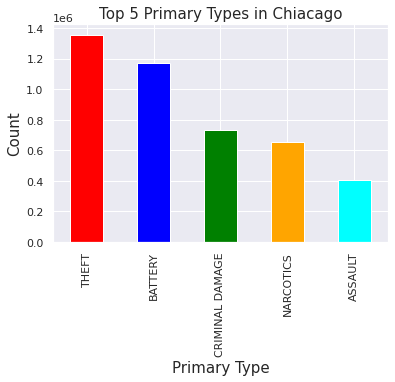

In [8]:
sns.set()
colors=['red','blue','green','orange','cyan']
crimes_primarytype_top5 = crimes_primarytype.head(5)
crimes_primarytype_top5.plot(kind='bar',colors=colors)
plt.xlabel('Primary Type',fontsize =15)
plt.ylabel('Count',fontsize= 15)
plt.title('Top 5 Primary Types in Chiacago',fontsize = 15 )


## Observation From the Primary Type

* From the reported crimes we see Theft cases are more reported in the greater chicago  area followed by Battery and Criminal Damage,Narcotics,Assault.

    * THEFT : 1356765
    * BATTERY : 1169770
    * CRIMINAL DAMAGE : 729277
    * NARCOTICS : 652702
    * ASSAULT  : 402285
* Finally,THEFT and BATTERY are most Happening crimes in chicago



# Which is the most described Description 

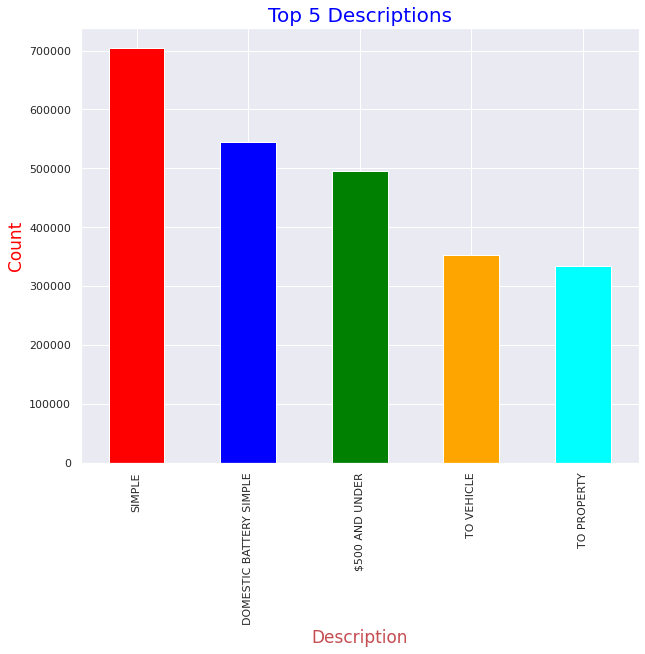

In [9]:
colors=['red','blue','green','orange','cyan']
count_Description.plot(kind = 'bar', color = colors, figsize=(10,8))
plt.title('Top 5 Descriptions', fontsize='20',color='blue')
plt.xlabel('Description', fontsize= '17', color = 'r')
plt.ylabel('Count', fontsize= '17', color = 'red')
plt.annotate
plt.show()

# Observation 
* Most of the crimes were described as simple and some of them are related to vehicle and property and some of them with Fine.
* Most of the crimes where not involved with human Injury 

# Locations


# Which locations are greatly involved in crime

/usr/local/lib/python3.6/dist-packages/pandas/plotting/_matplotlib/core.py:203: UserWarning: 'colors' is being deprecated. Please use 'color'instead of 'colors'
  "'colors' is being deprecated. Please use 'color'"


Text(0.5, 1.0, 'Top 5 Location for crimes in Chiacago')

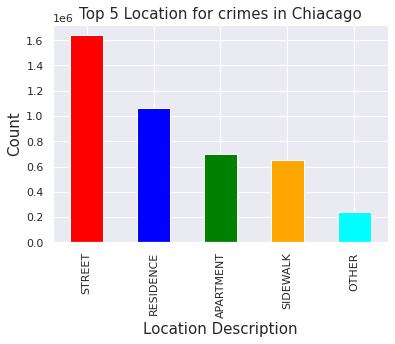

In [10]:
crimes_LocationDescription = crimes['Location Description'].value_counts().head(5)
crimes_LocationDescription.plot(kind='bar',colors=colors)
plt.xlabel('Location Description',fontsize =15)
plt.ylabel('Count',fontsize= 15)
plt.title('Top 5 Location for crimes in Chiacago',fontsize = 15 )


# Observations From location Description
* Top 5 dangerous locations to occur crime.
* Streets are the most dangerous places for possibility of crime rather then residence and appartments.
* Crimes count is almost equal at both Apartments and sidewalks.

# comparision of Arrest vs Non arrest


In [11]:
crimes_arrest = crimes['Arrest'].value_counts()
crimes_arrest

0    4647825
1    1742794
Name: Arrest, dtype: int64

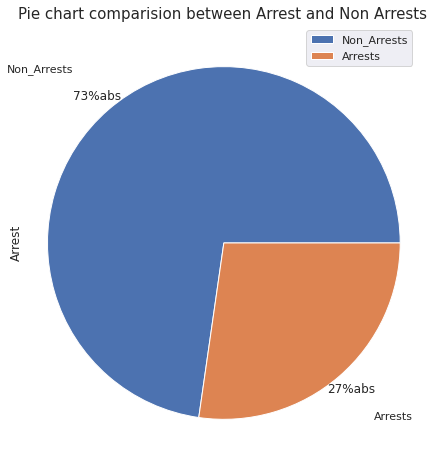

In [12]:
labels = ['Non_Arrests','Arrests']
crimes_arrest.plot.pie(figsize = (7,8), autopct = '%1.0f%%abs', pctdistance = 1.1, labeldistance = 1.3, labels = labels)
plt.legend(loc='upper right')
plt.title('Pie chart comparision between Arrest and Non Arrests',fontsize=15)
plt.axis('equal')
plt.show()

# Observation from the ARRESTS columns
* 73 % of the crimes ended with the Non Arrest
* Only 27 percents of the crimes have Arrests

# Domestic column

In [13]:
crimes_Domestic  = crimes.Domestic.value_counts()
crimes_Domestic

0    5532631
1     857988
Name: Domestic, dtype: int64

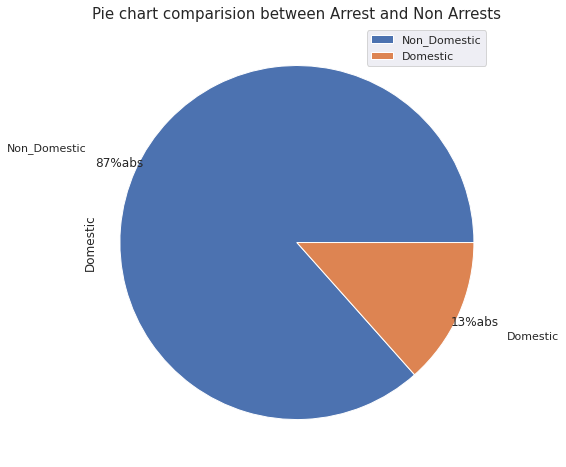

In [14]:
labels = ['Non_Domestic','Domestic']
crimes_Domestic.plot.pie(figsize = (7,8), autopct = '%1.0f%%abs', pctdistance = 1.1, labeldistance = 1.3, labels = labels)
plt.legend(loc='upper right')
plt.title('Pie chart comparision between Arrest and Non Arrests',fontsize=15)
plt.axis('equal')
plt.show()

# Observations 
* Most of the crimes occured in the Non domestic Region , 87 percent of the crimes occurred in the Non Domestic areas


# Primary_Type Comparision with Arrests

In [15]:
crimes_primary_nonarrests = crimes.groupby(['Arrest'])['Primary Type'].value_counts()[0].head(10)
crimes_primary_arrests = crimes.groupby(['Arrest'])['Primary Type'].value_counts()[1].head(10)
crimes_primary_arrests


Primary Type
NARCOTICS             648851
BATTERY               266491
THEFT                 156944
CRIMINAL TRESPASS     132167
ASSAULT                91904
OTHER OFFENSE          71787
PROSTITUTION           60391
WEAPONS VIOLATION      56569
CRIMINAL DAMAGE        50502
DECEPTIVE PRACTICE     38962
Name: Primary Type, dtype: int64

Text(0, 0.5, 'Number of Arrests')

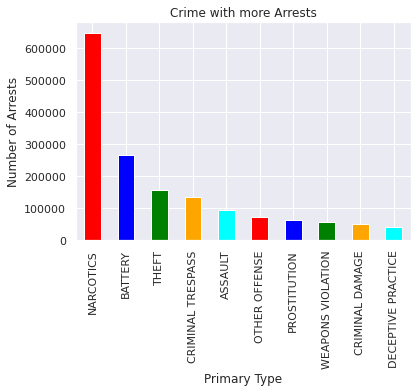

In [16]:
crimes_primary_arrests.plot(kind='bar',color=colors)
plt.title('Crime with more Arrests')
plt.xlabel('Primary Type')
plt.ylabel('Number of Arrests')


# Observations
* Most of the arrests are linked with Narcotics
* In the above chart we see thefts are most happened crimes in the Chicago 
* From the chart "crimes with more arrest" Number of Arrests for Theft cases are about 156944 but the total number of cases where 1356765 
* coming to the Narcotics almost all the case related to Narcotics were reported as Arrested


# Primary type comparision with Domestic and Non Domestic

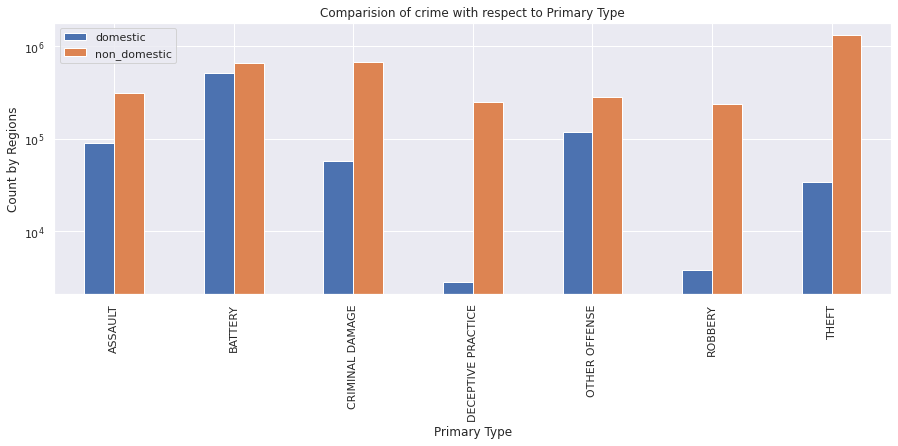

In [17]:

crimes_primary_Domestic = crimes.groupby(['Domestic'])['Primary Type'].value_counts(dropna=True)[1].head(10)
crimes_primary_Non_Domestic = crimes.groupby(['Domestic'])['Primary Type'].value_counts(dropna=True)[0].head(10)
crimes_Domestic_bar = pd.DataFrame({'domestic':crimes_primary_Domestic,'non_domestic':crimes_primary_Non_Domestic})
crimes_Domestic_bar.dropna(inplace=True)
crimes_Domestic_bar.plot(kind='bar',figsize = (15,5))
plt.title('Comparision of crime with respect to Primary Type')
plt.xlabel('Primary Type')
plt.ylabel('Count by Regions')
plt.yscale('log')


# Observations
* Almost all the Thefts where happened in the Non Domestic regions
*  Domestic regions faces more BATTERY type crimes
* Battery Type crimes is available in both the regions
* crimes like DECEPTIVE PRACTICE and ROBBERY's are very low in Domestic Regions 



In [18]:
crimes_Domestic_bar.dropna()

,domestic,non_domestic
ASSAULT,88795.0,313490.0
BATTERY,507793.0,661977.0
CRIMINAL DAMAGE,57818.0,671459.0
DECEPTIVE PRACTICE,2822.0,251371.0
OTHER OFFENSE,117599.0,279312.0
ROBBERY,3775.0,237761.0
THEFT,33710.0,1323055.0


# Heat map of crimes based on Districts

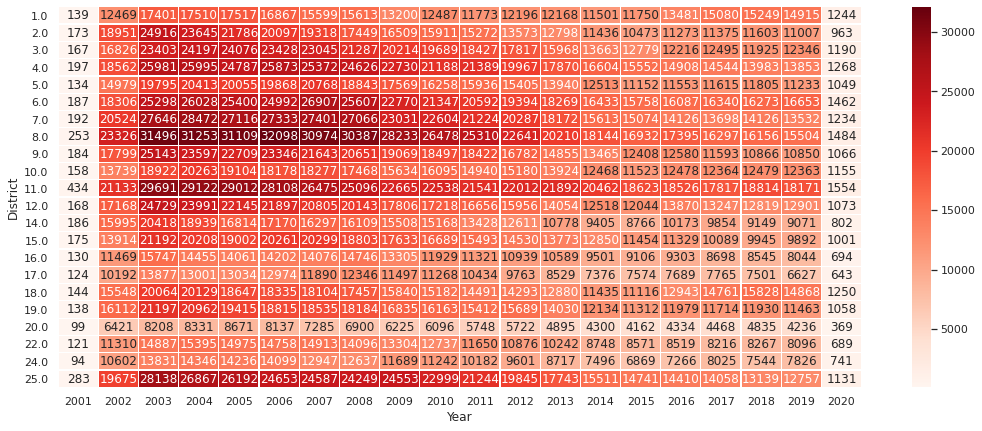

In [19]:
corr = crimes.groupby(['District','Year']).count().ID.unstack().dropna()
fix, ax = plt.subplots(figsize=(18,7))
sns.set(font_scale=1.0)
sns.heatmap(corr,linewidths=0.2,annot=True,fmt='g',cmap='Reds')

* There is no such symmetry  in the heat map,but the district 11.0 receiving almost equal number of crimes all the years.
* From the Map we can see the crimes neighbouring to most dangerous district were also affecting
* From 2001 to 2011 ,Distric 8  and 11 received more crimes count.
* All the districts neighbouring to Distric 8 receiving more crimes too.
* Out of all districts, 20.0 shows minimal number crimes,we can say district 20.0 is safest and district 11.0 is the most dangerorus  all the time 
* District 1 and 18 shows the gradual increase of crime 


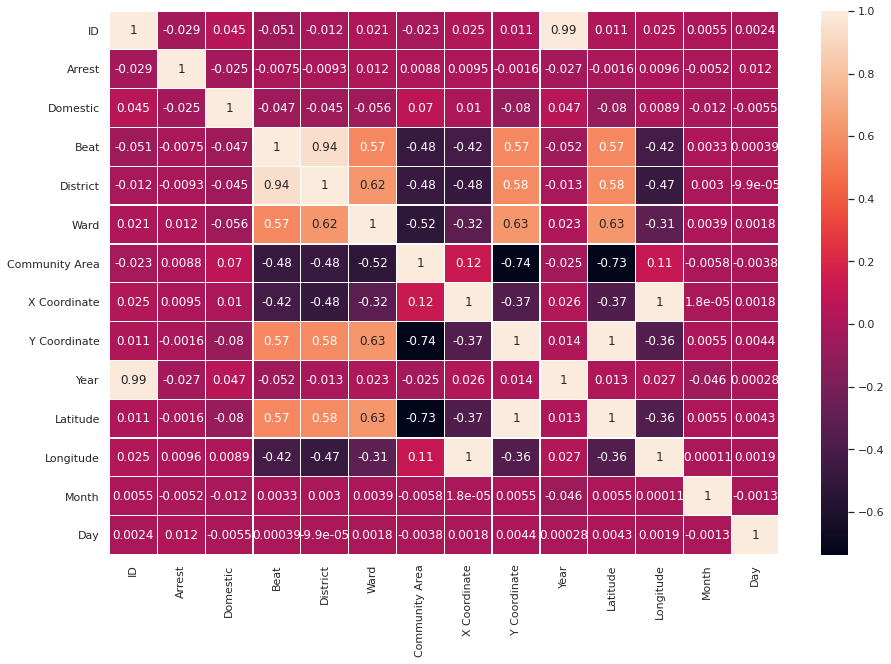

In [20]:

plt.subplots(figsize=(15,10))
crimes_correlation = crimes_theft.corr()
sns.heatmap(crimes_correlation,annot=True,linewidths=0.2)

/usr/local/lib/python3.6/dist-packages/pandas/plotting/_matplotlib/tools.py:307: MatplotlibDeprecationWarning: 
The rowNum attribute was deprecated in Matplotlib 3.2 and will be removed two minor releases later. Use ax.get_subplotspec().rowspan.start instead.
  layout[ax.rowNum, ax.colNum] = ax.get_visible()
/usr/local/lib/python3.6/dist-packages/pandas/plotting/_matplotlib/tools.py:307: MatplotlibDeprecationWarning: 
The colNum attribute was deprecated in Matplotlib 3.2 and will be removed two minor releases later. Use ax.get_subplotspec().colspan.start instead.
  layout[ax.rowNum, ax.colNum] = ax.get_visible()
/usr/local/lib/python3.6/dist-packages/pandas/plotting/_matplotlib/tools.py:313: MatplotlibDeprecationWarning: 
The rowNum attribute was deprecated in Matplotlib 3.2 and will be removed two minor releases later. Use ax.get_subplotspec().rowspan.start instead.
  if not layout[ax.rowNum + 1, ax.colNum]:
/usr/local/lib/python3.6/dist-packages/pandas/plotting/_matplotlib/tools.py:3

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7fb0b66d8978>,
      dtype=object)

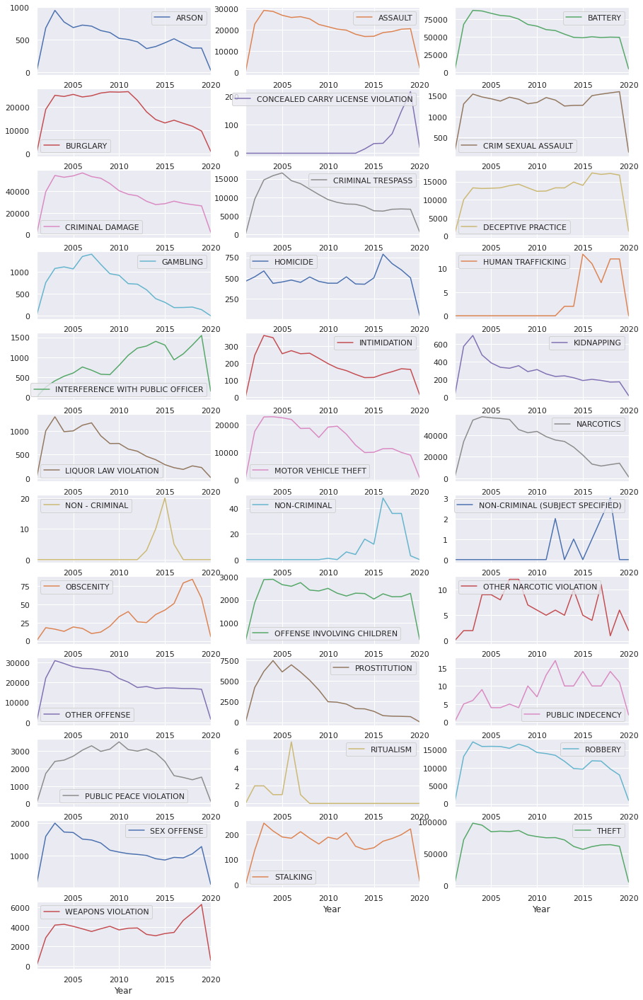

In [21]:
a = crimes.groupby(['Year','Primary Type'])['Year'].count().unstack().fillna(0)
a.plot(figsize=(15,25),layout=(-1,3),subplots=True,sharex=False,sharey=False)

* Weapon Violation shows increasing over the years
* Stalking and Sex offence shows downward trend in between the years
* Buglary,Kidnapping,vehicle Theft crimes reducing over the years

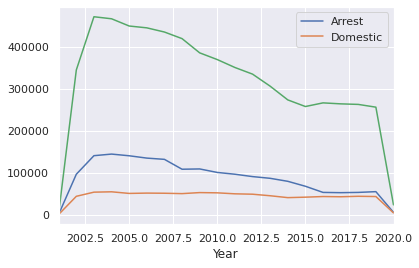

In [22]:
crimes_sumbyyear = crimes.drop(columns =['FBI Code', 'X Coordinate',
       'Y Coordinate', 'Updated On', 'Latitude', 'Longitude',
       'Location', 'Month', 'Day'])
crimes_sumbyyear_AD = crimes_sumbyyear.groupby(['Year'])['Arrest','Domestic'].sum()
crimes_countbyyear_IDWC = crimes_sumbyyear.groupby(['Year']).count().ID
crimes_sumbyyear_AD.plot()
crimes_countbyyear_IDWC.plot()


# which hours are receiving more number of crimes?


In [0]:
crimes['Weekday'] = crimes.index.dayofweek
crimes['Hour'] = crimes.index.hour
crimes['Month'] = crimes.index.month
crimes_domestic =  crimes[crimes['Domestic']==1]
crimes_nondomestic = crimes[crimes['Domestic']==0]

/usr/local/lib/python3.6/dist-packages/pandas/plotting/_matplotlib/tools.py:307: MatplotlibDeprecationWarning: 
The rowNum attribute was deprecated in Matplotlib 3.2 and will be removed two minor releases later. Use ax.get_subplotspec().rowspan.start instead.
  layout[ax.rowNum, ax.colNum] = ax.get_visible()
/usr/local/lib/python3.6/dist-packages/pandas/plotting/_matplotlib/tools.py:307: MatplotlibDeprecationWarning: 
The colNum attribute was deprecated in Matplotlib 3.2 and will be removed two minor releases later. Use ax.get_subplotspec().colspan.start instead.
  layout[ax.rowNum, ax.colNum] = ax.get_visible()
/usr/local/lib/python3.6/dist-packages/pandas/plotting/_matplotlib/tools.py:313: MatplotlibDeprecationWarning: 
The rowNum attribute was deprecated in Matplotlib 3.2 and will be removed two minor releases later. Use ax.get_subplotspec().rowspan.start instead.
  if not layout[ax.rowNum + 1, ax.colNum]:
/usr/local/lib/python3.6/dist-packages/pandas/plotting/_matplotlib/tools.py:3

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7fb0b59e0e80>,
      dtype=object)

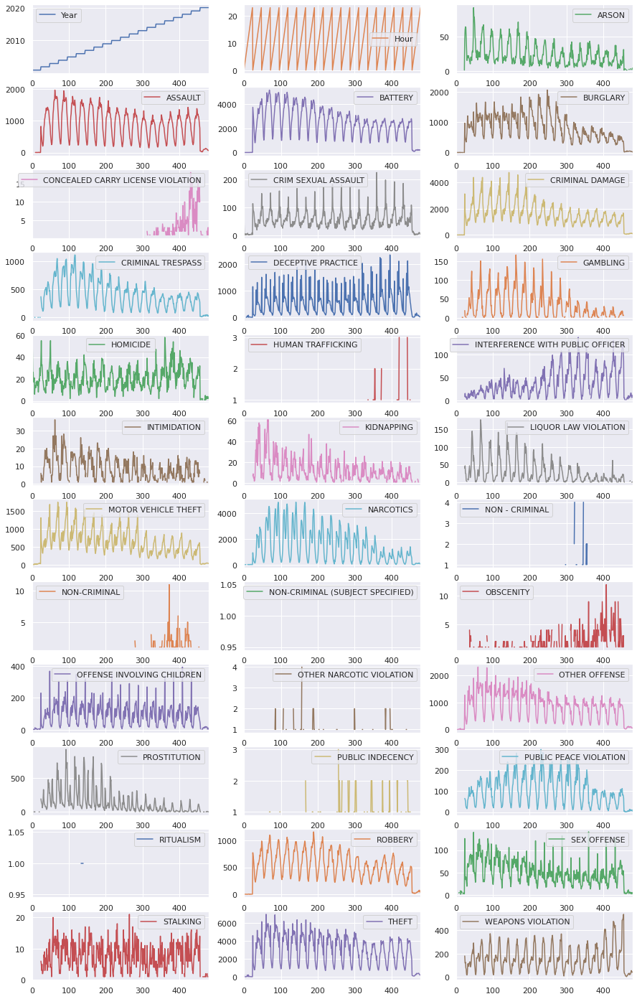

In [27]:
data = crimes.groupby(['Year','Hour'])['Primary Type'].value_counts().unstack().reset_index()
data.plot(figsize=(15,25),layout=(-1,3),subplots=True,sharex=False,sharey=False)

In [28]:
print('For Non Domestic Type of violance : {} Rows and {} Columns'.format(crimes_nondomestic.shape[0],crimes_nondomestic.shape[1]))
print('For  Domestic Type violance : {} Rows and {} Columns'.format(crimes_domestic.shape[0],crimes_domestic.shape[1]))

For Non Domestic Type of violance : 5532631 Rows and 26 Columns
For  Domestic Type violance : 857988 Rows and 26 Columns


# How is the activity of CRIME  w.r.t Domestic Areas

Text(0.5, 1.0, 'Comparision of crimes at Domestic and Non Domestic places')

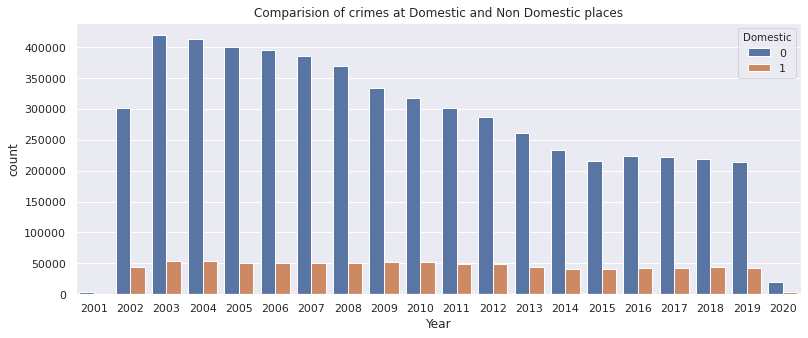

In [29]:
plt.figure(figsize=(13,5))
sns.countplot(x ='Year',hue='Domestic', data = crimes[['Year','Domestic']])
plt.title('Comparision of crimes at Domestic and Non Domestic places')

* Over all, Almost most Number of crimes are happening in the Non Domestic areas 


# Comparision of arrest and Non arrest  of Crimes

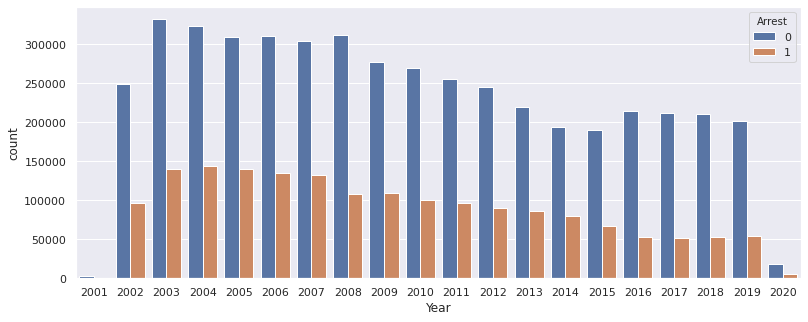

In [30]:
plt.figure(figsize=(13,5))
sns.countplot(x='Year',hue='Arrest',data=crimes[['Year','Arrest']].reset_index())

* The Arrest and the Non Arrests are directly proportional to each other,though they are not equal in values.
* Count decreases with the decrease in crime 

# Which month has more Arrest's and Non Arrest's

[Text(0, 0, 'Jan'),
 Text(0, 0, 'Feb'),
 Text(0, 0, 'Mar'),
 Text(0, 0, 'Apr'),
 Text(0, 0, 'May'),
 Text(0, 0, 'June'),
 Text(0, 0, 'July'),
 Text(0, 0, 'Aug'),
 Text(0, 0, 'Sep'),
 Text(0, 0, 'Oct'),
 Text(0, 0, 'Nov'),
 Text(0, 0, 'Dec')]

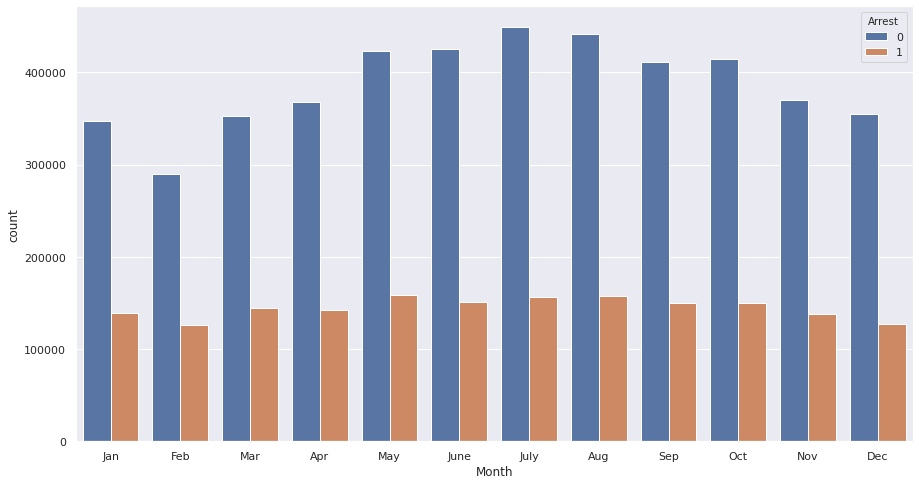

In [31]:
# comparison of arrest and non arrests months 
months = ['Jan','Feb','Mar','Apr','May','June','July','Aug','Sep','Oct','Nov','Dec']
fig,ax = plt.subplots(figsize=(15,8))
sns.countplot(x= 'Month',hue='Arrest',data=crimes)
ax.set_xticklabels(months)

* Most Non arrests are reported in the month of July
* Most Number of Arrests were reported in the month of May.
* Number of Arrests from may to oct are same , where for end of the yease show decreasing.same with Non arrests

# Which day of the week reports more Crimes 

[Text(0, 0, 'Sunday'),
 Text(0, 0, 'Monday'),
 Text(0, 0, 'Tuesday'),
 Text(0, 0, 'Wednesday'),
 Text(0, 0, 'Thursday'),
 Text(0, 0, 'Friday'),
 Text(0, 0, 'Saturday')]

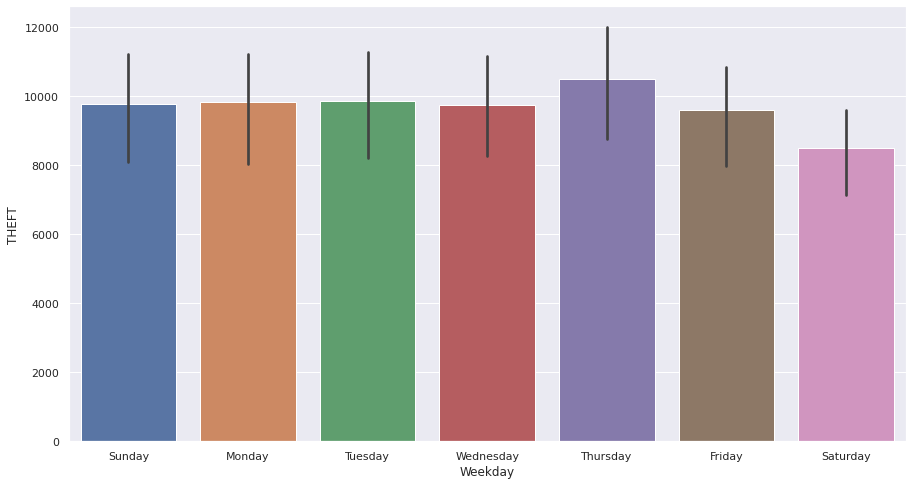

In [32]:
fig, ax = plt.subplots(figsize=(15,8))
sns.barplot(x='Weekday',y='THEFT',data=crimes.groupby(['Year','Weekday'])['Primary Type'].value_counts().unstack().reset_index())
ax.set_xticklabels(['Sunday','Monday','Tuesday','Wednesday','Thursday','Friday','Saturday'])

* More number of crimes are reported on Thursday 

# What is the peak hour for crimes

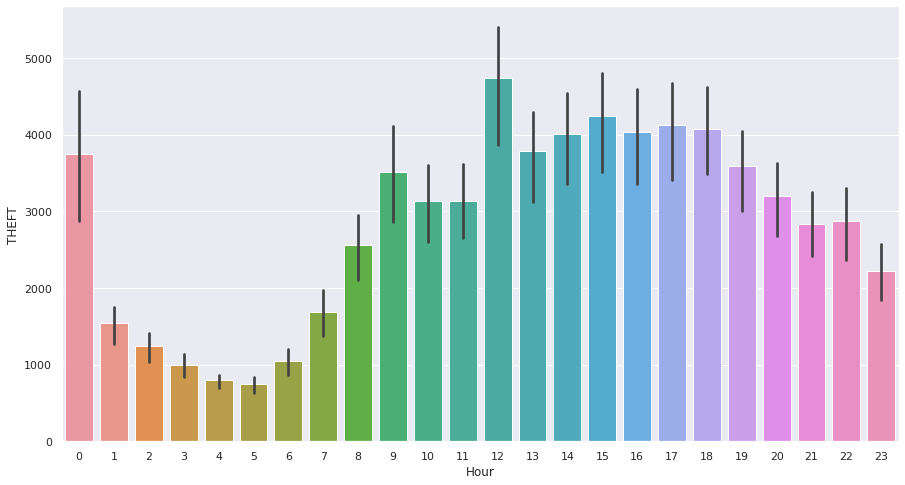

In [33]:
# Theft based on hours
fig,ax = plt.subplots(figsize=(15,8))
sns.barplot(x= 'Hour',y='THEFT',data=crimes.groupby(['Year','Hour'])['Primary Type'].value_counts().unstack().reset_index())

Observation : 
* All overday there are crimes happening in the chicago.
* 9 am to 6pm is peak time for the occurance of crimes 
* 12 am and 12 pm hours shows sudden rise of crimes compared to previous and next hours .


# Which month Reports most crimes? 

[Text(0, 0, 'Jan'),
 Text(0, 0, 'Feb'),
 Text(0, 0, 'Mar'),
 Text(0, 0, 'Apr'),
 Text(0, 0, 'May'),
 Text(0, 0, 'June'),
 Text(0, 0, 'July'),
 Text(0, 0, 'Aug'),
 Text(0, 0, 'Sep'),
 Text(0, 0, 'Oct'),
 Text(0, 0, 'Nov'),
 Text(0, 0, 'Dec')]

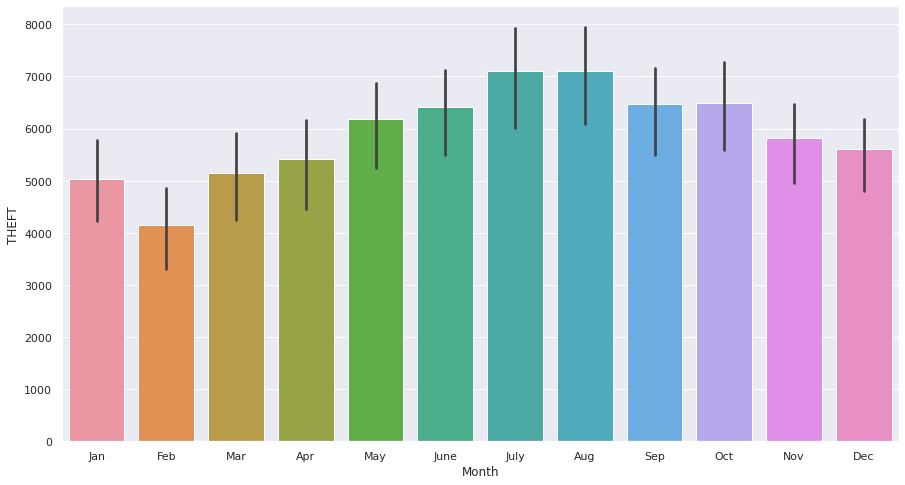

In [34]:
# by month
fig,ax = plt.subplots(figsize=(15,8))
sns.barplot(x= 'Month',y='THEFT',data=crimes.groupby(['Year','Month'])['Primary Type'].value_counts().unstack().reset_index())
months = ['Jan','Feb','Mar','Apr','May','June','July','Aug','Sep','Oct','Nov','Dec']
ax.set_xticklabels(months)

* July and August has more number of crimes 
* Feb has the least number of crimes

# Which district  is more dangerous?


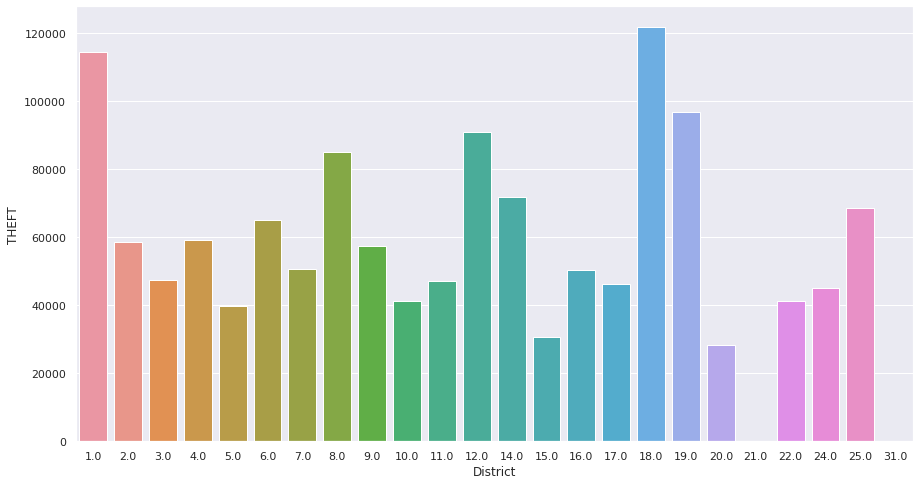

In [35]:
# which distric is  more dangerous and less
fig,ax=plt.subplots(figsize=(15,8))
sns.barplot(x='District',y='THEFT', data=crimes_theft.groupby(['District'])['Primary Type'].value_counts().unstack().reset_index())


* District 18.0 is more dangerous, followed by 1.0
* Distric 20.0 seems most safest of all 

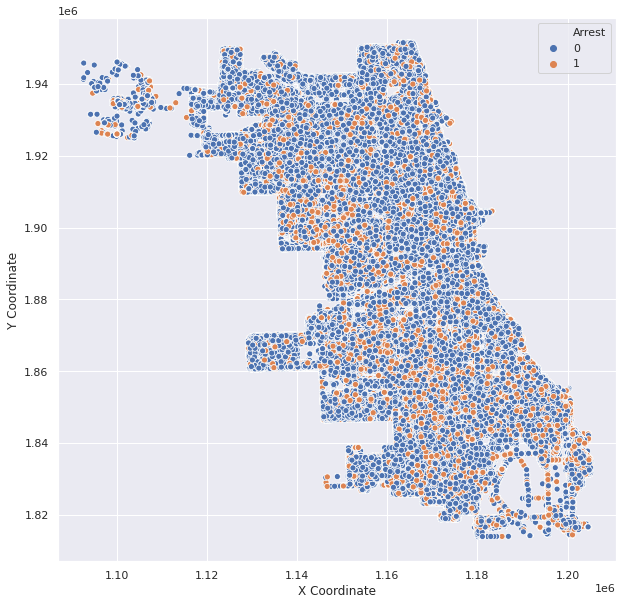

In [36]:
crimes_plot = crimes.loc[(crimes['X Coordinate']!=0)]
plt.subplots(figsize=(10,10))
sns.scatterplot(x='X Coordinate',y='Y Coordinate',hue='Arrest',data=crimes_plot,ci =2)

* Most of the Arrests happened on the Left side of the Chicaga Area

# Spread of all Crimes in the Chicago Area






/usr/local/lib/python3.6/dist-packages/seaborn/regression.py:574: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


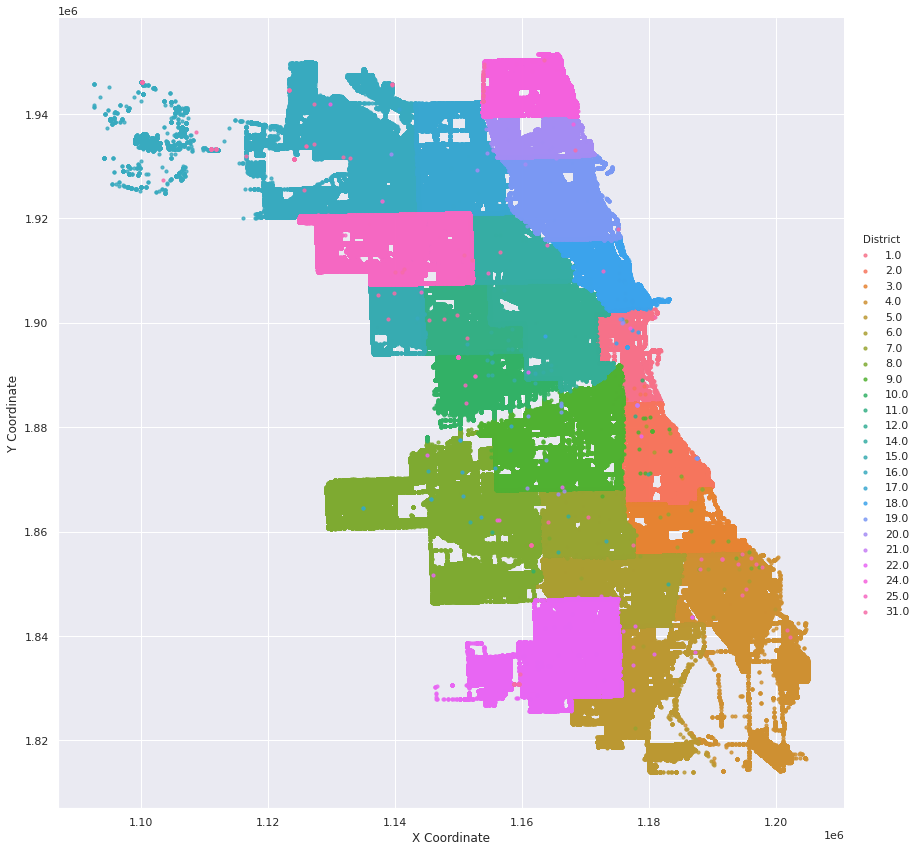

In [37]:
sns.lmplot(x='X Coordinate', y='Y Coordinate',hue='District',data = crimes_plot[:],fit_reg=False,size = 12, ci =2 ,scatter_kws={"marker":"D","s":10})

In [0]:
def generateBaseMap(default_location=[41.8781,-87.6298], default_zoom_start=12):
    base_map = folium.Map(location=default_location, control_scale=True, zoom_start=default_zoom_start)
    return base_map



In [39]:
basemap = generateBaseMap()
basemap

In [46]:
from folium.plugins import HeatMap
base_map = generateBaseMap()
HeatMap(data=crimes[['Latitude', 'Longitude', 'Arrest']].groupby(['Latitude', 'Longitude']).sum().reset_index().values.tolist(), radius=8, max_zoom=13).add_to(base_map)
base_map